In [4]:
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Dense, MaxPool2D, Flatten, Dropout, Input, concatenate, Conv2DTranspose,BatchNormalization,GroupNormalization, Add
from tensorflow.keras.activations import leaky_relu, relu
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping,ModelCheckpoint
import numpy as np
import librosa
import IPython.display as ipd
import matplotlib.pyplot as plt
import soundfile as sf

In [5]:
n_fft = 1022
frame_size = 1022
patch_size = 128
hop_length = 768
freq_bin = 512
sampling_rate = 16000
# sampling_rate = 8192
dropout = 0.3
kernel_size = (5,5)

## Defining U-Net CNN architecture

In [39]:
# Contractio
inputs = Input((512,128,1))
print('input', inputs)
c1 = Conv2D(16, kernel_size, strides=(2,2), kernel_initializer='he_normal', padding='same')(inputs)
c1 = BatchNormalization()(c1)
c1 = leaky_relu(x=c1, negative_slope=0.2)
print("c1", c1)

c2 = Conv2D(32, kernel_size, strides=(2,2), kernel_initializer='he_normal', padding='same')(c1)
c2 = BatchNormalization()(c2)
c2 = leaky_relu(x=c2, negative_slope=0.2)
print("c2", c2)


c3 = Conv2D(64, kernel_size, strides=(2,2), kernel_initializer='he_normal', padding='same')(c2)
c3 = BatchNormalization()(c3)
c3 = leaky_relu(x=c3, negative_slope=0.2)
print("c3", c3)


c4 = Conv2D(128, kernel_size, strides = (2,2), kernel_initializer='he_normal', padding='same')(c3)
c4 = BatchNormalization()(c4)
c4 = leaky_relu(x = c4, negative_slope=0.2)
print("c4", c4)


c5 = Conv2D(256, kernel_size, strides = (2,2), kernel_initializer='he_normal', padding='same')(c4)
c5 = BatchNormalization()(c5)
c5 = leaky_relu(x = c5, negative_slope=0.2)
print("c5", c5)


c6 = Conv2D(512, kernel_size, strides = (2,2), kernel_initializer='he_normal', padding='same')(c5)
c6 = BatchNormalization()(c6)
c6 = leaky_relu(x = c6, negative_slope = 0.2)
print("c6", c6)


# # Expansion
u7 = Conv2DTranspose(256, kernel_size, strides = (2,2),kernel_initializer = 'he_normal', padding='same')(c6)
u7 = BatchNormalization()(u7)
u7 = relu(u7)
u7 = Dropout(0.5)(u7)
u7 = concatenate([c5, u7])
print("u7", u7)
c7 = Conv2D(256, kernel_size, kernel_initializer = 'he_normal', padding='same')(u7)
c7 = BatchNormalization()(c7)
c7 = relu(c7)
print("c7", c7)

u8 = Conv2DTranspose(128, kernel_size, strides = (2,2), kernel_initializer = 'he_normal',padding = 'same')(c7)
u8 = BatchNormalization()(u8)
u8 = relu(u8)
u8 = Dropout(0.5)(u8)
u8 = concatenate([c4, u8])
print("u8", u8)
c8 = Conv2D(128, kernel_size,kernel_initializer = 'he_normal', padding = 'same')(u8)
c8 = BatchNormalization()(c8)
c8 = relu(c8)
print("c8", c8)

u9 = Conv2DTranspose(64, kernel_size, strides=(2,2), kernel_initializer = 'he_normal',padding='same')(c8)
u9 = BatchNormalization()(u9)
u9 = relu(u9)
u9 = Dropout(0.5)(u9)
u9 = concatenate([u9, c3])
print("u9", u9)
c9 = Conv2D(64, (5,5),kernel_initializer = 'he_normal', padding = 'same')(u9)
c9 = BatchNormalization()(c9)
c9 = relu(c9)
print("c9", c9)


u10 = Conv2DTranspose(32, kernel_size, strides=(2,2), kernel_initializer = 'he_normal',padding='same')(c9)
u10 = BatchNormalization()(u10)
u10 = relu(u10)
u10 = concatenate([u10, c2])
print("u10", u10)
c10 = Conv2D(32, (5,5),kernel_initializer = 'he_normal', padding = 'same')(u10)
c10 = BatchNormalization()(c10)
c10 = relu(c10)
print("c10", c10)


u11 = Conv2DTranspose(16, kernel_size, strides=(2,2), kernel_initializer = 'he_normal', padding='same')(c10)
u11 = BatchNormalization()(u11)
u11 = relu(u11)
u11 = concatenate([u11, c1])
print("u11", u11)
c11 = Conv2D(16, kernel_size,kernel_initializer = 'he_normal', padding = 'same')(u11)
c11 = BatchNormalization()(c11)
c11 = relu(c11)
print("c11", c11)

c12 = Conv2DTranspose(8, kernel_size, strides=(2,2), kernel_initializer = 'he_normal', padding='same')(c11)
c12 = BatchNormalization()(c12)
c12 = relu(c12)
print("c12", c12)

output = Conv2D(1, (1,1), padding='same', activation='sigmoid')(c12)
print("output", output)

input <KerasTensor shape=(None, 512, 128, 1), dtype=float32, sparse=False, name=keras_tensor_186>
c1 <KerasTensor shape=(None, 256, 64, 16), dtype=float32, sparse=False, name=keras_tensor_189>
c2 <KerasTensor shape=(None, 128, 32, 32), dtype=float32, sparse=False, name=keras_tensor_192>
c3 <KerasTensor shape=(None, 64, 16, 64), dtype=float32, sparse=False, name=keras_tensor_195>
c4 <KerasTensor shape=(None, 32, 8, 128), dtype=float32, sparse=False, name=keras_tensor_198>
c5 <KerasTensor shape=(None, 16, 4, 256), dtype=float32, sparse=False, name=keras_tensor_201>
c6 <KerasTensor shape=(None, 8, 2, 512), dtype=float32, sparse=False, name=keras_tensor_204>
u7 <KerasTensor shape=(None, 16, 4, 512), dtype=float32, sparse=False, name=keras_tensor_209>
c7 <KerasTensor shape=(None, 16, 4, 256), dtype=float32, sparse=False, name=keras_tensor_212>
u8 <KerasTensor shape=(None, 32, 8, 256), dtype=float32, sparse=False, name=keras_tensor_217>
c8 <KerasTensor shape=(None, 32, 8, 128), dtype=float32

In [7]:
model = Model(inputs = inputs, outputs = output)

In [8]:
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 512, 128,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 256, 64,   │        416 │ input_layer[0][0] │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 256, 64,   │         64 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_relu          │ (None, 256, 64,   │          0 │ batch_normalizat… │
│ (LeakyRelu)         │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 128, 32,   │     12,832 │ leaky_relu[0][0]  │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 32,   │        128 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_relu_1        │ (None, 128, 32,   │          0 │ batch_normalizat… │
│ (LeakyRelu)         │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 64, 16,    │     51,264 │ leaky_relu_1[0][… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 16,    │        256 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_relu_2        │ (None, 64, 16,    │          0 │ batch_normalizat… │
│ (LeakyRelu)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 32, 8,     │    204,928 │ leaky_relu_2[0][… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 8,     │        512 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_relu_3        │ (None, 32, 8,     │          0 │ batch_normalizat… │
│ (LeakyRelu)         │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 16, 4,     │    819,456 │ leaky_relu_3[0][… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 16, 4,     │      1,024 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_relu_4        │ (None, 16, 4,     │          0 │ batch_normalizat… │
│ (LeakyRelu)         │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 8, 2, 512) │  3,277,312 │ leaky_relu_4[0][

 Total params: 13,108,049 (50.00 MB)

 Trainable params: 13,104,033 (49.99 MB)

 Non-trainable params: 4,016 (15.69 KB)

## Loading train and validation dataset

In [6]:
X_train = np.load('Dataset/X_train.npy').astype(np.float32)
Y_train = np.load('Dataset/Y_train_vocal.npy').astype(np.float32)

X_train = np.transpose(X_train, (2, 0, 1))  # Change to (n, 512, 128)
X_train = X_train[..., np.newaxis]  # Add channel dimension, shape becomes (n, 512, 128, 1)

Y_train = np.transpose(Y_train, (2, 0, 1))  # Change to (n, 512, 128)
Y_train = Y_train[..., np.newaxis]  # Add channel dimension, shape becomes (n, 512, 128, 1)

X_train.shape, Y_train.shape

((3675, 512, 128, 1), (3675, 512, 128, 1))

In [7]:
X_valid = np.load('Dataset/X_valid.npy').astype(np.float32)
Y_valid = np.load('Dataset/Y_valid_vocal.npy').astype(np.float32)

X_valid = np.transpose(X_valid, (2, 0, 1))  # Change to (n, 512, 128)
X_valid = X_valid[..., np.newaxis]  # Add channel dimension, shape becomes (n, 512, 128, 1)

Y_valid = np.transpose(Y_valid, (2, 0, 1))  # Change to (n, 512, 128)
Y_valid = Y_valid[..., np.newaxis]  # Add channel dimension, shape becomes (n, 512, 128, 1)

X_valid.shape, Y_valid.shape

((325, 512, 128, 1), (325, 512, 128, 1))

In [8]:
dataset = tf.data.Dataset.from_tensor_slices((X_train, Y_train))
# Shuffle, batch, and prefetch the data
batch_size = 64 
dataset = dataset.shuffle(buffer_size=100).batch(batch_size).prefetch(tf.data.AUTOTUNE)

In [9]:
val_dataset = tf.data.Dataset.from_tensor_slices((X_valid, Y_valid))
val_dataset = val_dataset.batch(batch_size).prefetch(tf.data.AUTOTUNE)

In [10]:
def loss_function(y_true, y_predicted):
    return tf.reduce_mean(tf.abs(y_predicted - y_true))  # L1 loss (Mean Absolute Error)


## training

In [11]:
optimizer = tf.keras.optimizers.Adam()

In [12]:
epochs = 10

In [13]:
# Loop over epochs for vocal model
def train():
    for epoch in range(epochs):
        print(f"Epoch {epoch+1}/{epochs}")
        epoch_loss = 0;
        # Loop over batches in the dataset
        for batch, (mixed_batch, target_batch) in enumerate(dataset):
            with tf.GradientTape() as tape:
                # Forward pass: Get predictions from the model
                predicted_mask = model(mixed_batch, training=True)
    
                # Apply the mask to the mixed spectrogram
                predicted_spectrogram = predicted_mask * mixed_batch
                
                # Compute the loss
                loss = loss_function(target_batch, predicted_spectrogram)
            
            # Compute gradients
            gradients = tape.gradient(loss, model.trainable_variables)
            
            # Apply gradients
            optimizer.apply_gradients(zip(gradients, model.trainable_variables))
            
            # Optionally, print loss or metrics after every batch
            epoch_loss += loss.numpy()
        print(f"Loss = {epoch_loss}")

In [14]:
def validate():
    print("Validation:")
    validation_loss = 0
    
    # Iterate over validation dataset
    for batch, (mixed_batch, target_batch) in enumerate(val_dataset):
        # Forward pass: Get predictions from the model
        predicted_mask = model(mixed_batch, training=False)
        
        # Apply the mask to the mixed spectrogram (if needed)
        predicted_spectrogram = predicted_mask * mixed_batch
        
        # Compute the loss
        loss = loss_function(target_batch, predicted_spectrogram)
        
        # Accumulate the loss
        validation_loss += loss.numpy()
    
    # Optionally, compute the average validation loss
    average_validation_loss = validation_loss / len(val_dataset)
    print(f"Validation Loss = {average_validation_loss}")


In [41]:
train()
validate()

Epoch 1/10


2024-12-25 14:08:33.681018: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Loss = 0.14600242441520095
Epoch 2/10


2024-12-25 14:09:15.883181: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Loss = 0.14513816335238516
Epoch 3/10


2024-12-25 14:09:58.036629: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Loss = 0.1435421408386901
Epoch 4/10


2024-12-25 14:10:39.730986: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Loss = 0.142566237016581
Epoch 5/10


2024-12-25 14:11:22.933360: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Loss = 0.14168580679688603
Epoch 6/10


2024-12-25 14:12:03.989194: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Loss = 0.14011645875871181
Epoch 7/10


2024-12-25 14:12:45.191411: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Loss = 0.13942957937251776
Epoch 8/10


2024-12-25 14:13:25.736743: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Loss = 0.13844770286232233
Epoch 9/10


2024-12-25 14:14:06.573388: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Loss = 0.13784208963625133
Epoch 10/10


2024-12-25 14:14:47.750655: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


Loss = 0.13737614452838898
Validation:
Validation Loss = 0.005338310535686712


2024-12-25 14:14:48.556237: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


## Saving the model

In [ ]:
# model.save("model/model_0_08792585681658238.keras")
# model.save("../Music Source Separation host/music-source-separation-backend/models/model.keras") 

## using the trained model

In [9]:
model = tf.keras.models.load_model('../../Music Source Separation host/music-source-separation-backend/models/model.keras')

In [13]:
# Define a function to extract patches
def extract_patches(spectrogram, patch_size):
    num_frames = spectrogram.shape[1] 
    patches = []
    
    for i in range(0, num_frames - patch_size + 1, patch_size):
        # Slice a patch of 128 frames
        patch = spectrogram[:, i:i + patch_size]
        patches.append(patch)
    patches = np.stack(patches, axis=-1)
    return patches

def reconstruct_signal(patches):
    # Extract dimensions
    freq_bin, patch_size, num_of_patches = patches.shape

    # Reconstruct the original signal by concatenating patches along the time axis
    reconstructed_signal = np.zeros((freq_bin, patch_size * num_of_patches), dtype=patches.dtype)

    for index in range(num_of_patches):
        start_idx = index * patch_size
        reconstructed_signal[:, start_idx:start_idx + patch_size] = patches[:, :, index]


    return reconstructed_signal

def reconstruct_signal_from_patches(patches, phase,freq_bin, hop_length, frame_size, max_mag):
    y_mag = reconstruct_signal(patches)
    y_mag = y_mag * max_mag
    y_complex = y_mag * np.exp(1j * phase[:,:y_mag.shape[1]])
    # noise_estimate = np.mean(y_complex[:, :10], axis=1)
    # cleaned_spectrogram = np.maximum(y_complex - noise_estimate[:, np.newaxis], 0)
    y_reconst = librosa.istft(y_complex, n_fft=frame_size, hop_length=hop_length)
    
    return y_reconst

In [14]:
def isolate_voice(y):
    D = librosa.stft(y, n_fft=frame_size, hop_length=hop_length)
    magnitude_s = np.abs(D)
    phases = np.angle(D)
    
    magnitude_s = magnitude_s/np.max(magnitude_s)
    magnitude_s_max = np.max(magnitude_s)
    patches = extract_patches(magnitude_s, patch_size)
    
    patches = np.transpose(patches, (2, 0, 1))  # Change to (469, 512, 128)
    patches = patches[..., np.newaxis]  # Add channel dimension, shape becomes (469, 512, 128, 1)

    y_mask = model.predict(patches)
    modified_patches = patches * y_mask


    # Remove the channel dimension
    modified_patches = modified_patches.squeeze(-1)  # Shape becomes (14, 512, 128)
    
    # Transpose to match the expected shape for reconstruct_signal_from_patches
    modified_patches = np.transpose(modified_patches, (1, 2, 0))  # Shape becomes (512, 128, 14)
    
    y_isolated = reconstruct_signal_from_patches(modified_patches, phases, freq_bin, hop_length, frame_size, magnitude_s_max)
    print(y_isolated.shape)
    # background = y[:len(y_isolated)] - y_isolated
    return y_isolated

In [19]:
# D = librosa.stft(y, n_fft=frame_size, hop_length=hop_length)
# magnitude_s = np.abs(D)
# phases = np.angle(D)
# patches = extract_patches(magnitude_s, patch_size)
# patches = np.transpose(patches, (2, 0, 1))  # Change to (469, 512, 128)
# patches = patches[..., np.newaxis]
# print(patches.shape)
# mask_patches = model.predict(patches)
# mask_patches = mask_patches.squeeze(-1)
# mask_patches = np.transpose(mask_patches, (1, 2, 0))
# mask = reconstruct_signal(mask_patches)
# mag = mask * magnitude_s[:,:mask.shape[1]]
# y_complex = mag * np.exp(1j * phases[:,:mag.shape[1]])
# y_reconst = librosa.istft(y_complex, n_fft=frame_size, hop_length=hop_length)
# ipd.Audio(y_reconst, rate=sampling_rate)

In [29]:
audio_file_path = '../Dataset2/test/mixture.wav'
y, _ = librosa.load(audio_file_path, sr=sampling_rate)
print("Actual Music")
ipd.Audio(y, rate=sampling_rate)

Actual Music


In [17]:
from scipy.signal import butter, lfilter

def high_pass_filter(data, cutoff, fs, order=5):
    nyquist = 0.5 * fs
    normal_cutoff = cutoff / nyquist
    b, a = butter(order, normal_cutoff, btype='high', analog=False)
    return lfilter(b, a, data)

def band_pass_filter(data, lowcut, highcut, fs, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return lfilter(b, a, data)


In [30]:
isolated = isolate_voice(y)
isolated = isolate_voice(isolated)
print("Isolated Vocal")
# filtered_signal = high_pass_filter(isolated, cutoff=100, fs=sampling_rate)
filtered_signal = band_pass_filter(isolated, lowcut=300, highcut=3400, fs=sampling_rate)

ipd.Audio(isolated, rate=sampling_rate)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step
(3538176,)
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
(3538176,)
Isolated Vocal


Text(0.5, 1.0, 'original audio signal')

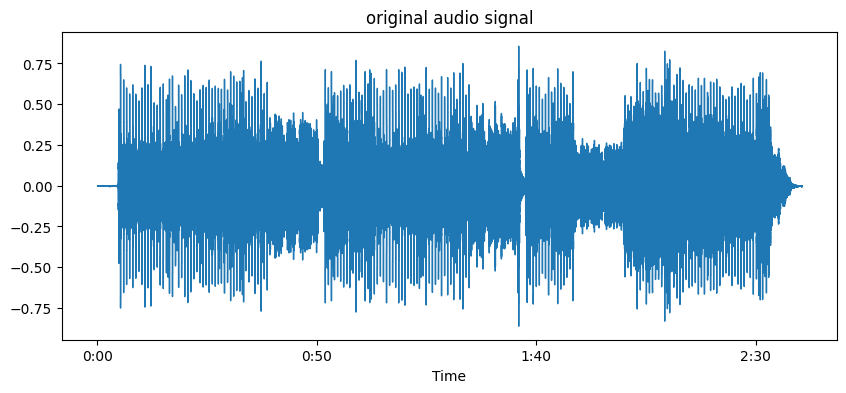

In [31]:
plt.figure(figsize=(10, 4))
librosa.display.waveshow(y)
plt.title("original audio signal")

Text(0.5, 1.0, 'voice signal')

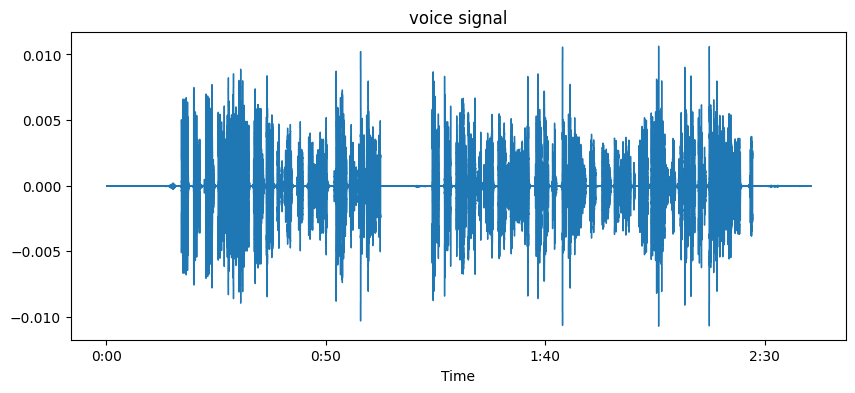

In [32]:
plt.figure(figsize=(10, 4))
librosa.display.waveshow(filtered_signal)
plt.title("voice signal")

## Calculating SDR

In [36]:
from mir_eval.separation import bss_eval_sources

In [34]:
ground_truth_audio,_ = librosa.load('./../Dataset2/vocals.wav', sr=sampling_rate)
y_snr, _ = librosa.load('./../Dataset2/mixture.wav', sr=sampling_rate)
predicted_audio = isolate_voice(y_snr)
ipd.Audio(predicted_audio, rate=sampling_rate)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
(3341568,)


In [38]:
predicted_audio = high_pass_filter(predicted_audio, cutoff=100, fs=sampling_rate)
sdr, sir, sar, perm = bss_eval_sources(ground_truth_audio[:len(predicted_audio)], predicted_audio)
print(f"SDR: {sdr}")

SDR: [6.89160582]
